In [1]:
import sys
import os
import json
import numpy as np
import pandas as pd
import imageio
from datetime import datetime, date, timedelta
import matplotlib.pyplot as plt
%matplotlib inline

# Images for Demo

In [4]:
geowiki = pd.read_csv('../data/planet/india/geowiki/geowiki_maharashtra.csv')
geowiki.head()

,image_id,x,y,name,name_value,0,in_maha,min_lon,max_lat,max_lon,min_lat
0,965377,79.354202,15.051000,Small (0.64 ha - 2.56 ha),2.0,3,False,79.347911,15.057075,79.360493,15.044925
1,965372,75.195801,18.250999,Very small (<0.64ha),1.0,2,True,75.189404,18.257075,75.202198,18.244924
2,965342,74.270798,19.742701,Small (0.64 ha - 2.56 ha),2.0,2,True,74.264343,19.748776,74.277252,19.736626
3,965144,78.545799,16.792700,Very small (<0.64ha),1.0,3,False,78.539454,16.798775,78.552145,16.786625
4,964937,75.154198,21.150999,Small (0.64 ha - 2.56 ha),2.0,3,True,75.147684,21.157074,75.160712,21.144924


In [10]:
base_dir = '../mount/data/airbus/false_color/'
image_names = sorted(os.listdir(base_dir))

image_ids = [int(x.split('_')[-1].split('.')[0]) for x in image_names]
samples = geowiki[geowiki['image_id'].isin(image_ids)].sort_values('image_id').reset_index(drop=True)

## Check if image is cropland

Note: we won't do this when we get labels for 1000 images. This is just for the demo.

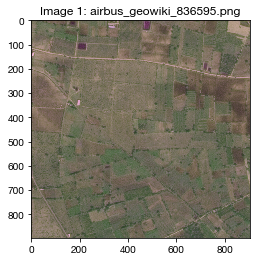

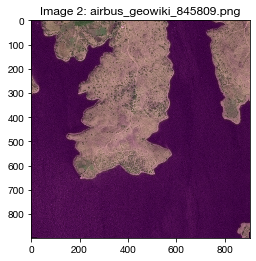

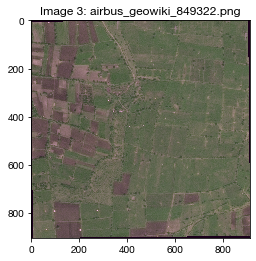

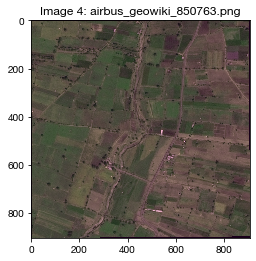

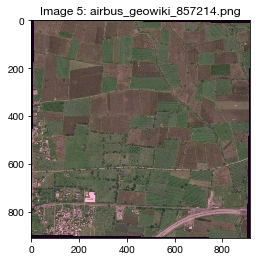

...

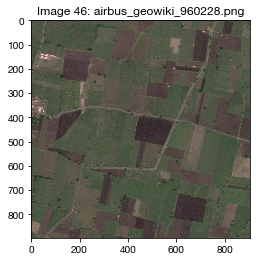

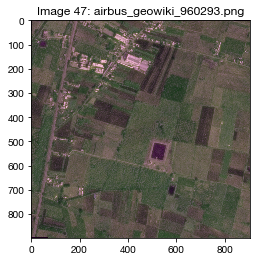

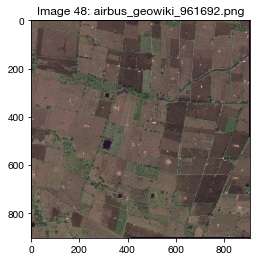

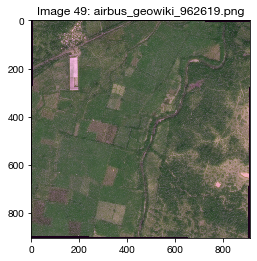

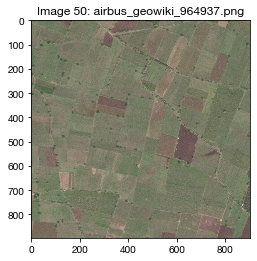

In [14]:
for i, image_name in enumerate(sorted(image_names)):
    img = imageio.imread(os.path.join(base_dir, image_name))
    plt.imshow(img)
    plt.title("Image {}: ".format(i+1) + image_name)
    plt.show()

In [16]:
cropland = [1, 0, 1, 1, 1, 1, 1, 0, 0, 0,
            1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
            1, 1, 1, 1, 1, 0, 1, 0, 1, 1,
            1, 1, 0, 1, 0, 1, 1, 1, 1, 1,
            1, 0, 0, 1, 1, 1, 1, 1, 1, 1]

In [17]:
samples['is_cropland'] = cropland

In [18]:
samples.head()

,image_id,x,y,name,name_value,0,in_maha,min_lon,max_lat,max_lon,min_lat,is_cropland
0,836595,75.287500,19.592688,Large (16 ha - 100 ha),4.0,1,True,75.281052,19.598763,75.293948,19.586613,1
1,845809,74.562500,19.334355,Small (0.64 ha - 2.56 ha),2.0,1,True,74.556062,19.340430,74.568938,19.328280,0
2,849322,76.512500,20.067688,Small (0.64 ha - 2.56 ha),2.0,3,True,76.506032,20.073763,76.518968,20.061613,1
3,850763,76.312500,18.642688,Small (0.64 ha - 2.56 ha),2.0,3,True,76.306089,18.648763,76.318911,18.636613,1
4,857214,78.720833,20.842688,Small (0.64 ha - 2.56 ha),2.0,3,True,78.714333,20.848763,78.727334,20.836613,1


### Add star to center of image?

In [20]:
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw

In [86]:
img = Image.open(os.path.join(base_dir, image_name))
x_center, y_center = img.size[1]/2., img.size[0]/2.
draw = ImageDraw.Draw(img)

fpath = os.path.join(plt.rcParams["datapath"], "fonts/ttf/HelveticaNeue.ttf")
font = ImageFont.truetype(fpath, 72)
draw.text((x_center-9, y_center-32), "*", (255, 70, 70), font=font)

In [87]:
img.crop((y_center-10, x_center-10, y_center+10, x_center+10))

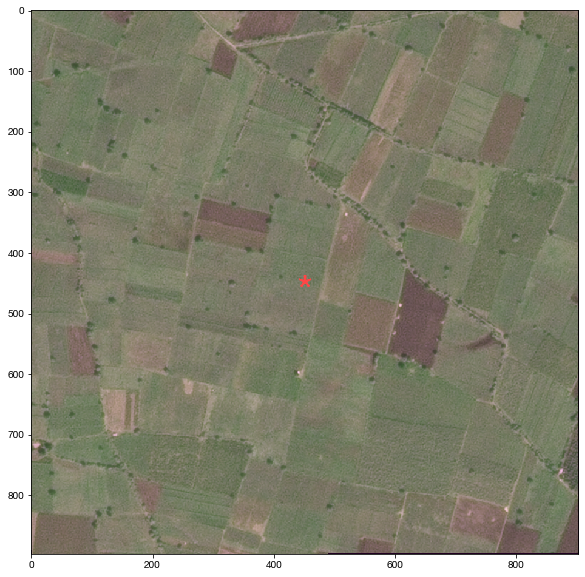

In [88]:
fig, ax = plt.subplots(1, figsize=(10,10))
plt.imshow(img)
plt.show()

In [94]:
save_dir = '../data/general_blockchain/airbus_false_color/'
fpath = os.path.join(plt.rcParams["datapath"], "fonts/ttf/HelveticaNeue.ttf")
font = ImageFont.truetype(fpath, 72)

for i, row in samples[samples['is_cropland'] == 1].reset_index(drop=True).iterrows():
    image_name = 'airbus_geowiki_{}.png'.format(row['image_id'])
    img = Image.open(os.path.join(base_dir, image_name))
    x_center, y_center = img.size[1]/2., img.size[0]/2.
    draw = ImageDraw.Draw(img)
    draw.text((x_center-9, y_center-32), "*", (255, 70, 70), font=font)
    
    new_name = "airbus_geowiki_A{}.png".format(str(i+1).zfill(2))
    img.save(os.path.join(save_dir, new_name))

In [103]:
label_ids = []
for i, row in samples[samples['is_cropland'] == 1].reset_index(drop=True).iterrows():
    label_ids.append("A{}".format(str(i+1).zfill(2)))

In [106]:
samples_to_send = samples[samples['is_cropland'] == 1].reset_index(drop=True)
samples_to_send['label_id'] = label_ids

In [108]:
samples_to_send.to_csv('../data/general_blockchain/geowiki_labeling_demo.csv', index=False)

## Static maps

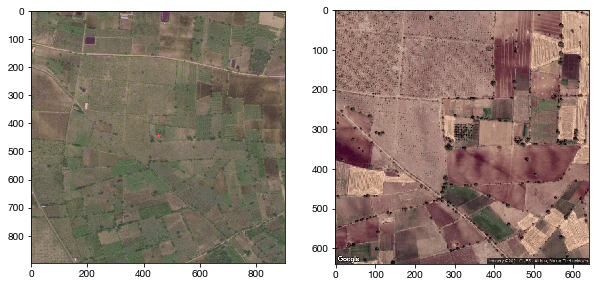

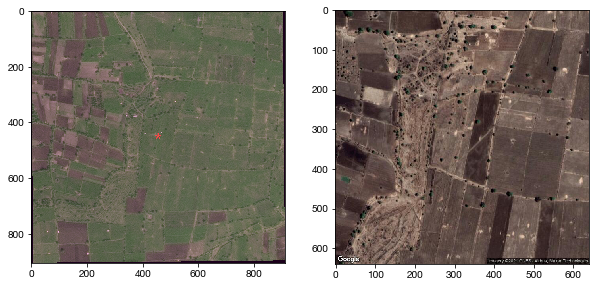

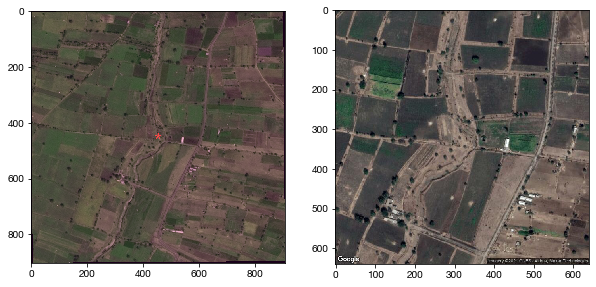

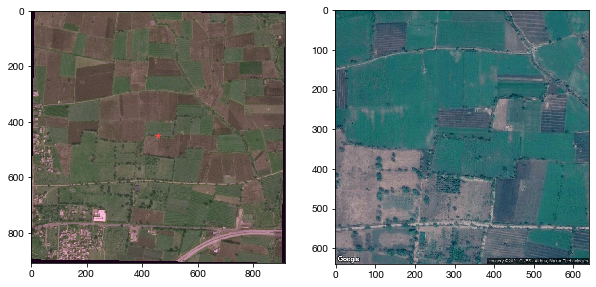

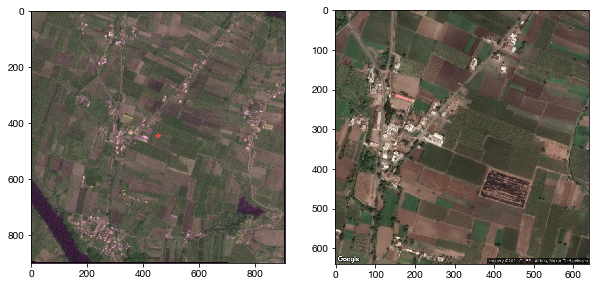

...

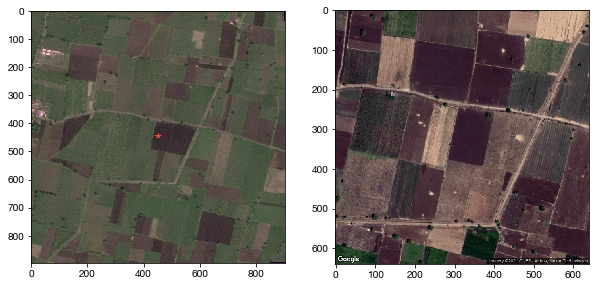

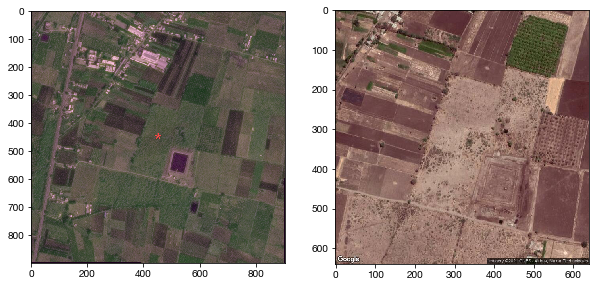

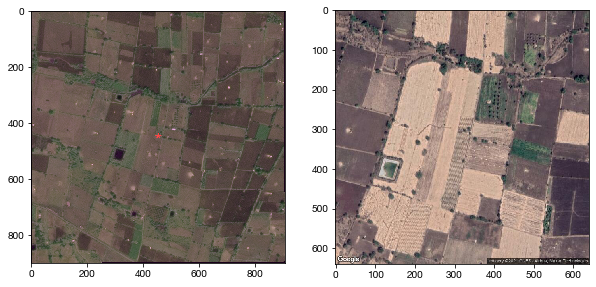

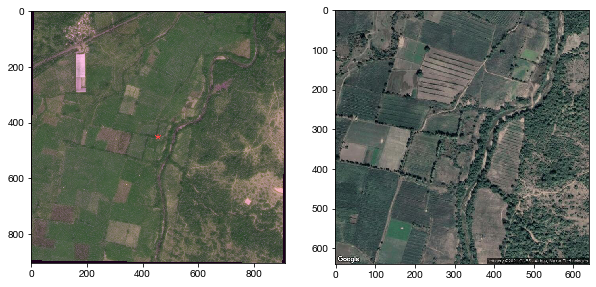

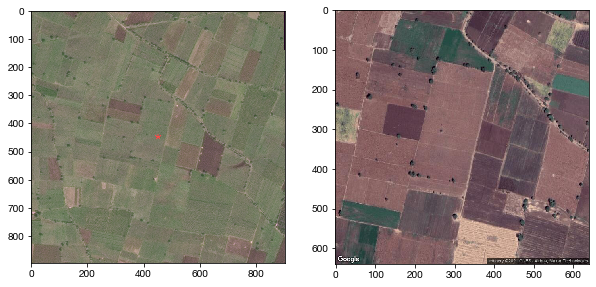

In [102]:
airbus_dir = '../data/general_blockchain/airbus_false_color/'
static_map_dir = '../data/static_maps/india/geowiki/'
new_static_map_dir = '../data/general_blockchain/static_maps/'

for i, row in samples[samples['is_cropland'] == 1].reset_index(drop=True).iterrows():
    airbus_name = os.path.join(airbus_dir, 'airbus_geowiki_A{}.png'.format(str(i+1).zfill(2)))
    airbus_img = imageio.imread(airbus_name)
    
    static_map_name = os.path.join(static_map_dir, '{}.jpg'.format(row['image_id']))
    static_map_img = imageio.imread(static_map_name)
    
    # save static map image
    new_static_map_name = "staticmap_geowiki_A{}.jpg".format(str(i+1).zfill(2))
    imageio.imwrite(os.path.join(new_static_map_dir, new_static_map_name), static_map_img)
    
    fig, ax = plt.subplots(1, 2, figsize=(10,10))
    ax[0].imshow(airbus_img)
    ax[1].imshow(static_map_img)
    plt.show()

In [109]:
samples_to_send[samples_to_send['image_id'] == 960228]

,image_id,x,y,name,name_value,0,in_maha,min_lon,max_lat,max_lon,min_lat,is_cropland,label_id
34,960228,75.304199,21.201,Small (0.64 ha - 2.56 ha),2.0,3,True,75.297683,21.207075,75.310715,21.194925,1,A35
